In [6]:
import os
os.chdir(r"C:\SPB_DATA") 

# Project 7: PID Control & Motors 

## Abstract & Description:


This week we'll be learning about controlling systems with feedback (including systems with electrical motors!). We're going to start with servo motors since they're the simplest. A servo motor is a closed-loop system that uses position feedback to control its motion and final position
The final goal is to control the position of the motor using a crude feedback mechanism. In other words, we need to set up the circuit + code and demonstrate that the feedback attempts to keep the light level on the photodiode constant by turning the motor. As a result, we were able to control our motor they way we wanted. The motor clearly turns on and the voltage drops from around 3.5 V to 1V. (see figure in results)
###### Stats:
For problem 1: Use the ideas from propagation of uncertainty to estimate the uncertainty in the given area, we found:

 $$\sigma_a \approx 707 \times 10^{-5}   $$

For problem 2: Use MC estimation to get the slope and intercept in the given set of numbers along with estimates of the uncertainty slope and intercept. we found:

m= 2.000 +/- 0.012 ( 2.012, 1.988 )
b= 1.000e+00 +/- 1.065e-01 ( 1.107e+00, 8.935e-01 )

## Circuit Schematic, Background and Discussion


First, we need to use the oscilloscope to study the behavior of the control line as we adjust the potentiometer and witness the motion of the servo. To do so, we built this program (see Code1 under Code Implementation) and attach a 0-5V potentiometer on A0 and the servo control line on pin 9. The servo-motor will also need power, which we can take from Vin and GND of the RedBoard.
 ###### Observation : 
 
 The motor position changes as we increase or decrease the voltage at the potentiometer.



There is a significant complexity buried in the "servo" object here (FYI you can find the servo object implementation under the Arduino Application 'libraries' folder). Let's dig in a bit deeper and implement this same functionality on the Cypress 5LP board.

We'll need to use an ADC (Analog to Digital Converter) and a PWM (Pulse Width Modulation) output and we will consider code2.

The Cypress 5LP project looks like this:

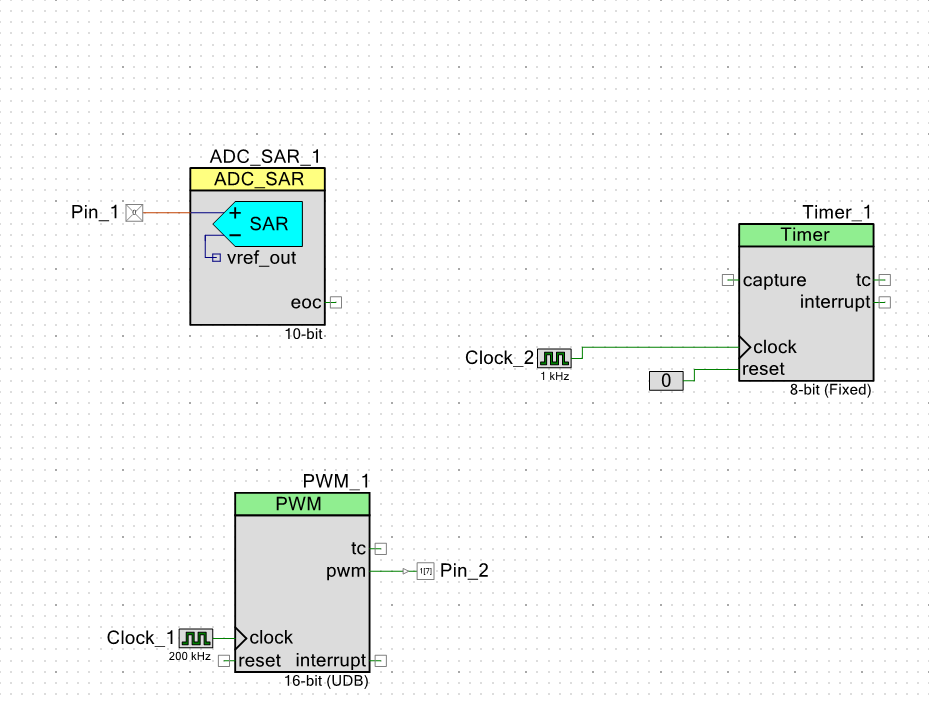

In [58]:
from IPython.display import Image
Image(filename='proj7B.png')

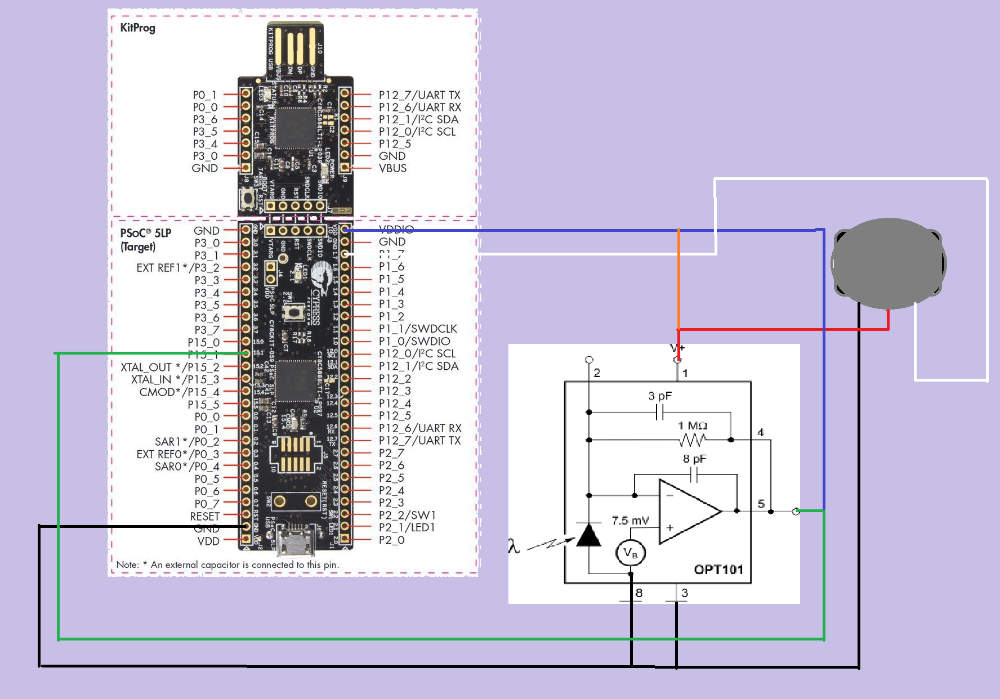

In [59]:
Image(filename='proj7A.png')


We also need to introduce the OPT 101 which will play a major role in our circuit. The 0.09 inch x 0.09 inch (2.29 mm × 2.29 mm) photodiode operates in the photoconductive mode for excellent linearity and low dark current.
This small device detects the changes in light and operates some changes, if asked to. 


###### Pins selected

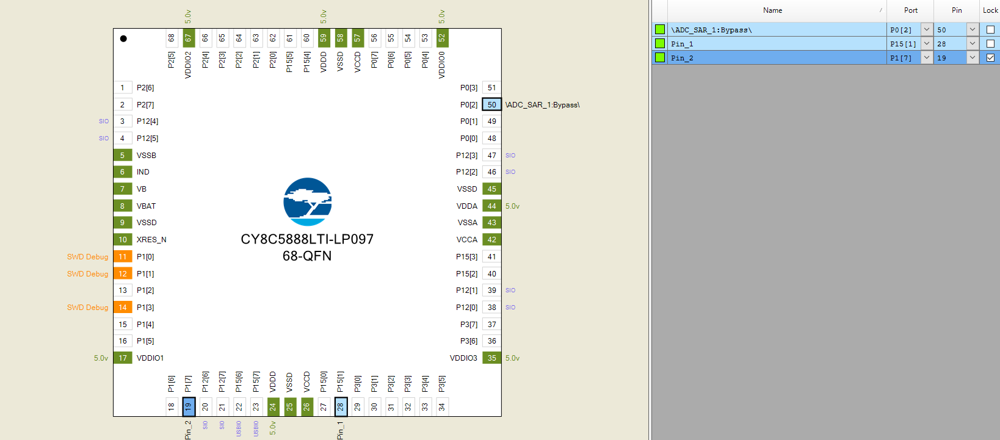

In [60]:
Image(filename='1c.png')

## Circuit Function
Code 1
=====
    #include <Servo.h>   //include the servo library

    int potPosition;     //this variable will store the position of the potentiometer
    int servoPosition;   //the servo will move to this position

    Servo myservo;       //create a servo object

    void setup() {

      myservo.attach(9); //tell the servo object that its servo is plugged into pin 9

    }

    void loop() {

        //use analog read to measure the position of the potentiometer (0-1023)

        potPosition = analogRead(A0);        
      
        //convert the potentiometer number to a servo position from 20-160
        //Note: its best to avoid driving the little SIK servos all the 
        //way to 0 or 180 degrees it can cause the motor to jitter, which is bad for the servo.

        servoPosition = map(potPosition, 0,1023,20,160);

        myservo.write(servoPosition); //move the servo to the 10 degree position
    }
Code 2
======

    #include "project.h"
    #include "simplePID.h"

    int main(void)
    {
        PID myPid;
    
    CyGlobalIntEnable; /* Enable global interrupts. */

    /* Place your initialization/startup code here (e.g. MyInst_Start()) */

    ADC_SAR_1_Start();
    PWM_1_Start();
    PID_Init(&myPid,0.0,400,0.0,0.0,1,400.0,200.0,100);
    for(;;)
    {
        /*long map(long x, long in_min, long in_max, long out_min, long out_max)
        // Place your application code here. */
        ADC_SAR_1_StartConvert();
        ADC_SAR_1_IsEndConversion(ADC_SAR_1_WAIT_FOR_RESULT);
        myPid.input = ADC_SAR_1_GetResult16();
        PID_Compute(&myPid);
        PWM_1_WriteCompare(myPid.output);
        CyDelay(100);
    }
}

/* [] END OF FILE */


## Results 




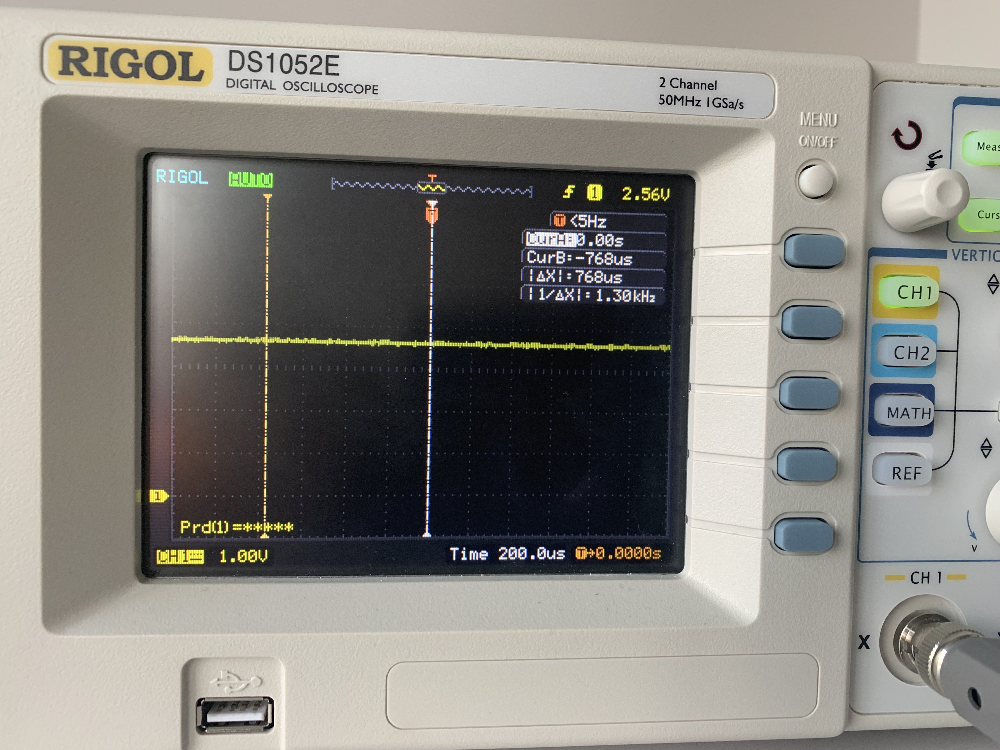

In [61]:
Image(filename='1a.jpg')


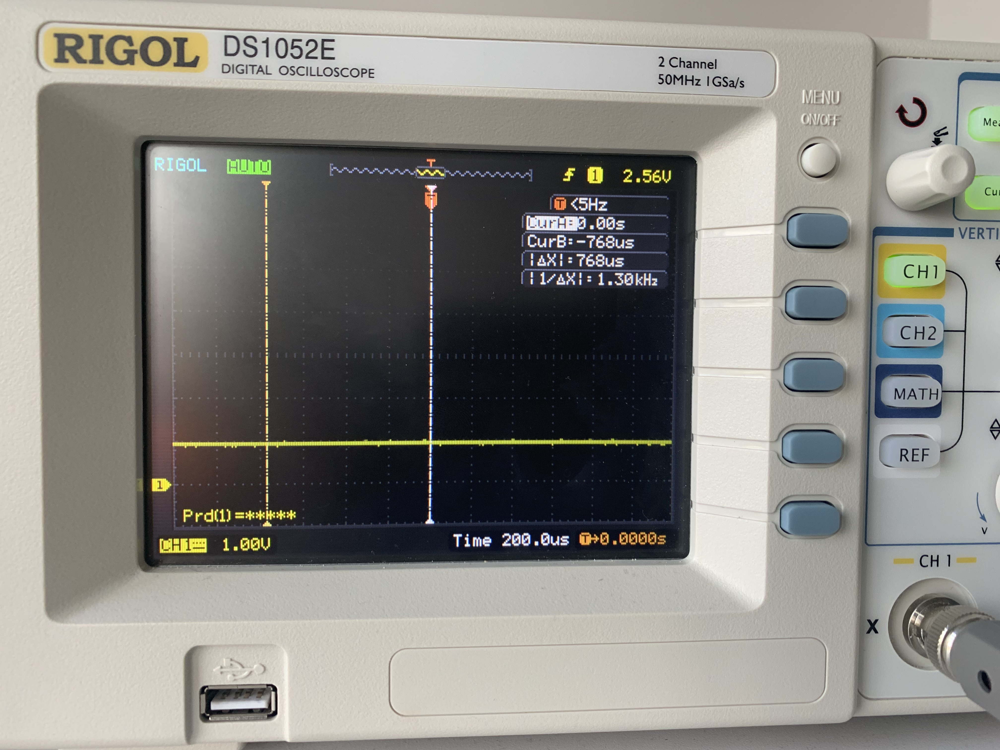

In [62]:
Image(filename='1b.jpg')


This is how the voltage drops once the motor turns on.

##### => Better representation:

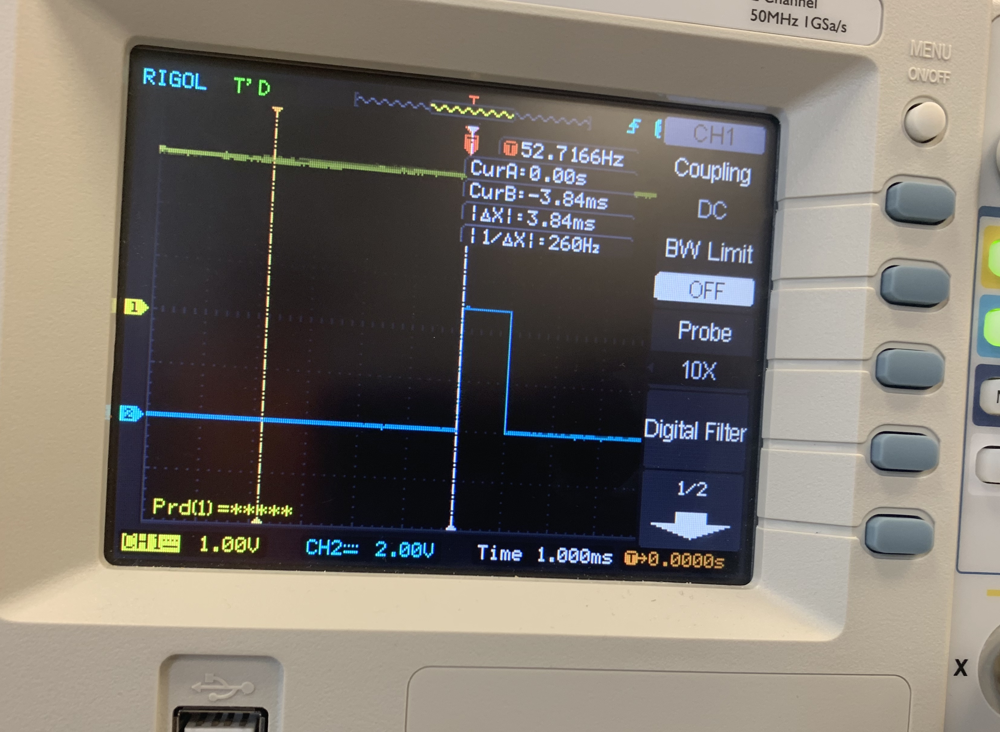

In [63]:
Image(filename='2a.jpg')


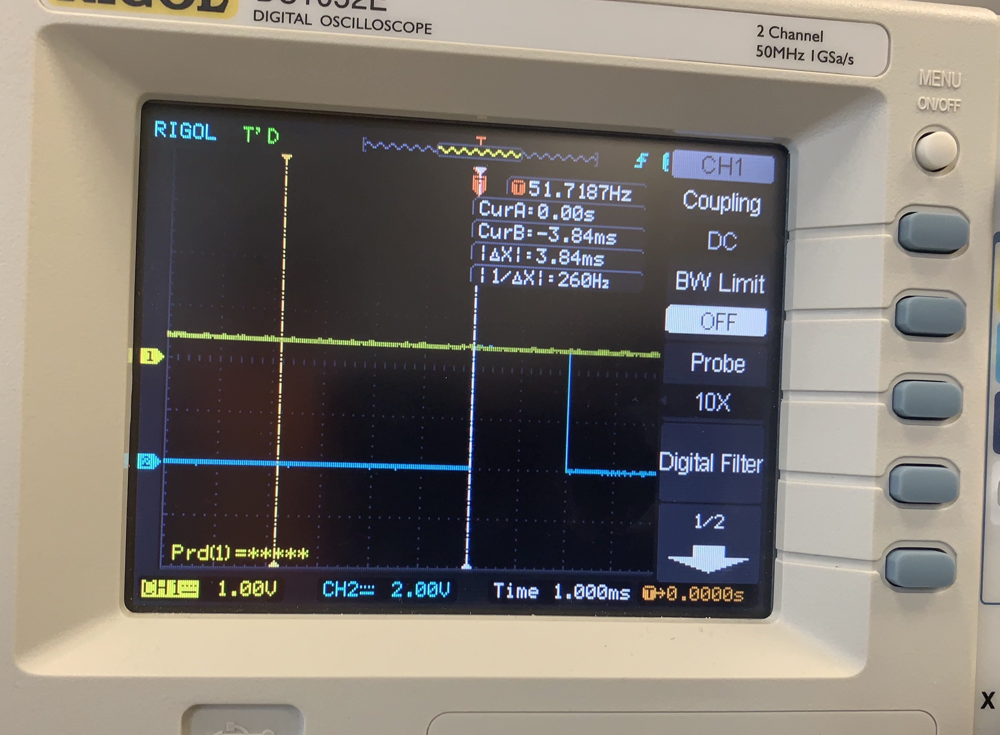

In [64]:
Image(filename='2b.jpg')


## Stats Exercises: Parameter Estimation




Suppose you want to cut out material for a thermal cover for an orbiting satellite. You want to estimate the uncertainty of the area (and hence mass) of the cover based on the precision with whcih you can measure the width and length of the cut. Suppose it's a 1-m x 1-m area with a precision of +/- 0.5 cm. Use the ideas from propagation of uncertainty to estimate the uncertainty in the area.

==>
If you have more than one variable contributing to the uncertainty in a calculation the *combined* uncertainty is calculated as the square root of the sum of the squares of the contribution from each item. Suppose you had a quantity $d$ that was related to quantities $a$, $b$ and $c$ in some arbitrary way so that $d$ was a function of $a$, $b$ and $c$. You could compute the uncertainty in $d$ as:

$$ \sigma_d^2 =  \left ( \frac{\partial d}{\partial a} \sigma_a \right)^2 + \left ( \frac{\partial d}{\partial b} \sigma_b \right)^2 + \left ( \frac{\partial d}{\partial c} \sigma_c \right)^2 $$


we obtain the following:
$$ \left ( \frac{\sigma_a}{a} \right)^2 =  \left ( \frac{0.005\,{\rm m}}{21\,{\rm m}} \right)^2 + \left (\frac{0.005\,{\rm m}}{1\,{\rm m}} \right)^2  = 5\times 10^{-6} m$$
let's forget a since it is one.
==> $$\sigma_a \approx 707 \times 10^{-5}   $$

Give the following data:

    x: 1,2,3,4,5,6    
    y: 3,5,7,9,11,13
    
  Assume that the uncertainty in the x values is +/- 0.1 and the y values is 0.2. Use MC estimation to get the slope and intercept along with estimates of the uncertainty in slope and intercept.
  
    
    


In [35]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as pl
import pandas as pd                    # pandas is the "python data analysis package"
import os                              # operating system services
from scipy.optimize import curve_fit   # non-linear curve fitting

In [67]:
#
# Now do monte-carlo data fabrication and fit analysis
#

N=1000    # number of samples to take
x =np.array( [1,2,3,4,5,6])
y = np.array([3,5,7,9,11,13])
sigma_x = .1
sigma_y = .2
m=[]  # keep track of monte-carlo fit parameters
b=[]


def model(x1,m,b): 
    return m*x1+b

for i in range(N):
    """
    Generate mc data with the same statistical properties as the real data.
    Repeat the fit for each set, and record the parameters.
    """
    mcX = x + sigma_x*np.random.normal(size=len(x))
    mcY = y + sigma_y*np.random.normal(size=len(y))
    par, cov = curve_fit(model, y, mcX)
    m.append(par[0])
    b.append(par[1])
#
# Compute the statistics of the mc-results
#
m0=2
b0=1
marr=np.array(m)
bArr=np.array(b)

mAvg = marr.mean()
Avg = bArr.mean()
sigm = marr.std(ddof=1)
sigb = bArr.std(ddof=1)
###
print("m= %5.3f +/- %5.3f ( %5.3f, %5.3f )" % (m0, sigm, m0+sigm, m0-sigm ))
print("b= %5.3e +/- %5.3e ( %5.3e, %5.3e )" % (b0, sigb, b0+sigb, b0-sigb ))


m= 2.000 +/- 0.012 ( 2.012, 1.988 )
b= 1.000e+00 +/- 1.037e-01 ( 1.104e+00, 8.963e-01 )


(array([  6.,  25.,  97., 187., 241., 235., 129.,  54.,  17.,   9.]),
 array([0.46354745, 0.47115948, 0.47877152, 0.48638356, 0.49399559,
        0.50160763, 0.50921967, 0.5168317 , 0.52444374, 0.53205578,
        0.53966781]),
 <a list of 10 Patch objects>)

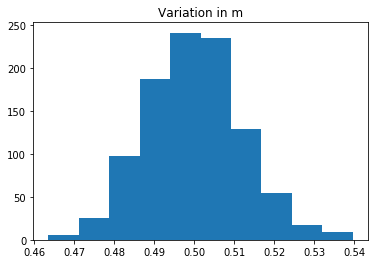

In [68]:
pl.title("Variation in m")
pl.hist(m)

(array([  9.,  21.,  68., 136., 256., 226., 176.,  76.,  24.,   8.]),
 array([-0.82947018, -0.76438178, -0.69929338, -0.63420499, -0.56911659,
        -0.50402819, -0.43893979, -0.37385139, -0.30876299, -0.24367459,
        -0.17858619]),
 <a list of 10 Patch objects>)

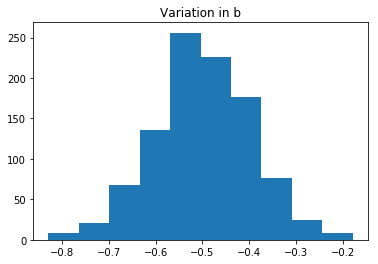

In [69]:
pl.title("Variation in b")
pl.hist(b)

## Conclusion

In this experiment, we learned how to control systems with feedback. we used servo motors and the experiment was clearly a success since the OPT 101 responded the way we expected. he feedback attempts to keep the light level on the photodiode constant by turning the motor. Dropping from 3.5V to 1V.

###### Stats:
For problem 1: Use the ideas from propagation of uncertainty to estimate the uncertainty in the given area, we found:

 $$\sigma_a \approx 707 \times 10^{-5}   $$

For problem 2: Use MC estimation to get the slope and intercept in the given set of numbers along with estimates of the uncertainty slope and intercept. we found:

m= 2.000 +/- 0.012 ( 2.012, 1.988 )
b= 1.000e+00 +/- 1.065e-01 ( 1.107e+00, 8.935e-01 )